**PROJET N°6 :** Classifiez automatiquement des biens de consommation

[Consignes du projet n°6](https://openclassrooms.com/fr/projects/631/assignment)

In [1]:
# %%flake8  # checking PEP8 compliance
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import functions.functions_p6 as functions_p6

# increase the maximum number of columns to display
pd.set_option("display.max_columns", 1000)  # Maximum number of columns

# Extraction du jeu de données déjà constitué

## Importation du fichier .csv

In [2]:
file_path = 'data/flipkart_com-ecommerce_sample_1050.csv'
data = pd.read_csv(file_path)
data.shape

(1050, 15)

In [3]:
data['product_url'].loc[0]

'http://www.flipkart.com/elegance-polyester-multicolor-abstract-eyelet-door-curtain/p/itmeg7bkzdgthcts?pid=CRNEG7BKMFFYHQ8Z'

In [4]:
data.head(1).T

,0
uniq_id,55b85ea15a1536d46b7190ad6fff8ce7
crawl_timestamp,2016-04-30 03:22:56 +0000
product_url,http://www.flipkart.com/elegance-polyester-mul...
product_name,Elegance Polyester Multicolor Abstract Eyelet ...
product_category_tree,"[""Home Furnishing >> Curtains & Accessories >>..."
pid,CRNEG7BKMFFYHQ8Z
retail_price,1899
discounted_price,899
image,55b85ea15a1536d46b7190ad6fff8ce7.jpg
is_FK_Advantage_product,False


In [5]:
data['product_specifications'].loc[1]

'{"product_specification"=>[{"key"=>"Machine Washable", "value"=>"Yes"}, {"key"=>"Material", "value"=>"Cotton"}, {"key"=>"Design", "value"=>"Self Design"}, {"key"=>"Brand", "value"=>"Sathiyas"}, {"key"=>"Type", "value"=>"Bath Towel"}, {"key"=>"GSM", "value"=>"500"}, {"key"=>"Model Name", "value"=>"Sathiyas cotton bath towel"}, {"key"=>"Ideal For", "value"=>"Men, Women, Boys, Girls"}, {"key"=>"Model ID", "value"=>"asvtwl322"}, {"key"=>"Color", "value"=>"Red, Yellow, Blue"}, {"key"=>"Size", "value"=>"Mediam"}, {"key"=>"Length", "value"=>"30 inch"}, {"key"=>"Width", "value"=>"60 inch"}, {"key"=>"Number of Contents in Sales Package", "value"=>"3"}, {"key"=>"Sales Package", "value"=>"3 Bath Towel"}]}'

In [6]:
data = data.drop(columns=[
    'crawl_timestamp',
    'product_url',
    'pid',
    'retail_price',
    'discounted_price',
    'is_FK_Advantage_product',
    'product_rating',
    'overall_rating',
    'brand',
    'product_specifications',
])

data.head(5)

,uniq_id,product_name,product_category_tree,image,description
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...
2,64d5d4a258243731dc7bbb1eef49ad74,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...
3,d4684dcdc759dd9cdf41504698d737d8,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...
4,6325b6870c54cd47be6ebfbffa620ec7,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...


### Valeurs dupliquées ?

In [7]:
data.duplicated().any()

False

### Valeurs manquantes ?

In [8]:
functions_p6.global_filling_rate(data)

DataFrame has 1050 rows and 5 columns.

Global filling rate of the DataFrame: 100.00%
Missing values in the DataFrame: 0 (0.00%)

Number of rows with missing values: 0 (0.00%)
Number of columns with missing values: 0 (0.00%)


## Parsing du dossier d'images

Récupération de l'image associée à un produit

In [9]:
image_name = data['image'].loc[0]

8 (3600, 3600) JPEG


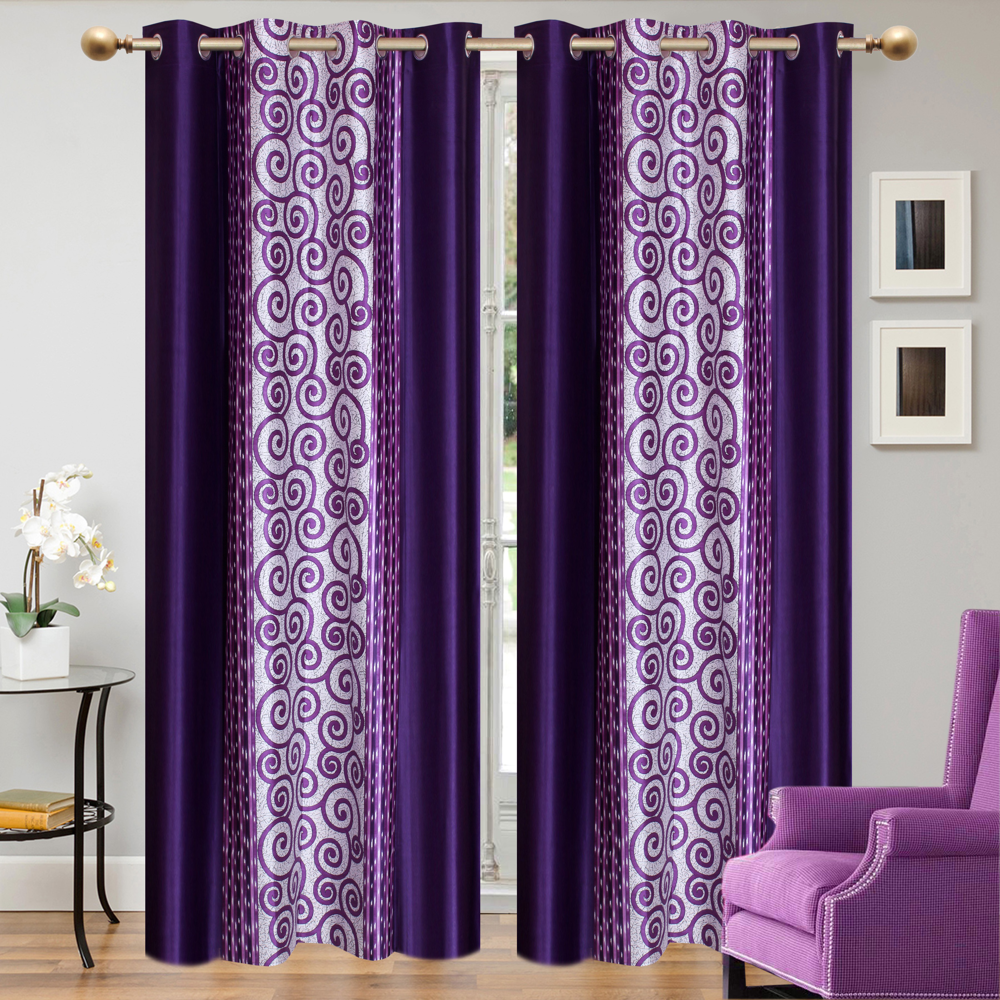

In [10]:
from PIL import Image
import os

image_name = data['image'].loc[0]
dir_name = 'data/Images'
file_path = os.path.join(dir_name, image_name)
jpgfile = Image.open(file_path)

print(jpgfile.bits, jpgfile.size, jpgfile.format)
display(jpgfile)

## Étude des répartitions des différentes catégories de produits

### Récupération des catégories à partir de 'product_category_tree'

In [11]:
# Definition of a function to apply or map
def get_categories_from_series(series):
    
    # --------------------------------------
    # Function to get the 3 first categories
    def get_categories_from_cell(cell):
        # Remove unwanted chars
        product_category_tree = cell.strip('[]"')

        # Get (at most) the 3 first categories of the category tree
        product_categories_list = product_category_tree.split(" >> ", 3)
        
        # Initialization
        categories = pd.Series()
        
        # for each category, add a row
        for i in range(len(product_categories_list)-1):
            categories["cat_{}".format(i+1)] = product_categories_list[i]
        
        # return pd.Series with 3 rows
        return categories

    # ------------------------------------------------
    # Proceed to the split
    categories_df = series.apply(get_categories_from_cell).fillna("")

    # Return the frequency_encoding pd.DataFrame
    return categories_df

categories_df = get_categories_from_series(data['product_category_tree'])


# Add the columns of categories to the data DataFrame
data = pd.concat(
    [data, categories_df],
    sort=False,
    axis=1
)

# Display results
data.head(2)

,uniq_id,product_name,product_category_tree,image,description,cat_1,cat_2,cat_3
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories,Curtains
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin,Baby Bath Towels


### Étude des effectifs des catégories de produit

In [12]:
# Reload importation of module
import importlib
importlib.reload(functions_p6)

<module 'functions.functions_p6' from 'D:\\OneDrive\\OpenClassrooms\\Parcours Data Scientist\\projet6\\functions\\functions_p6.py'>

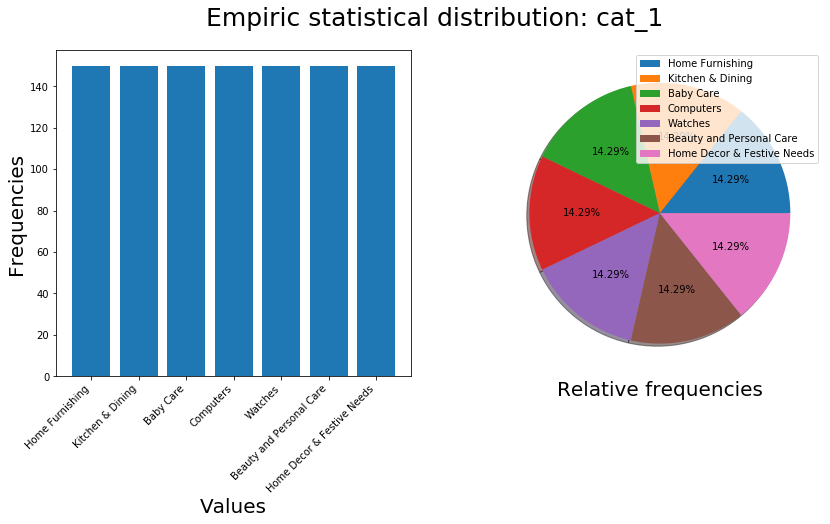

In [13]:
fig = functions_p6.categorical_distribution(data['cat_1'])
fig.savefig('plots/main_categories.png')

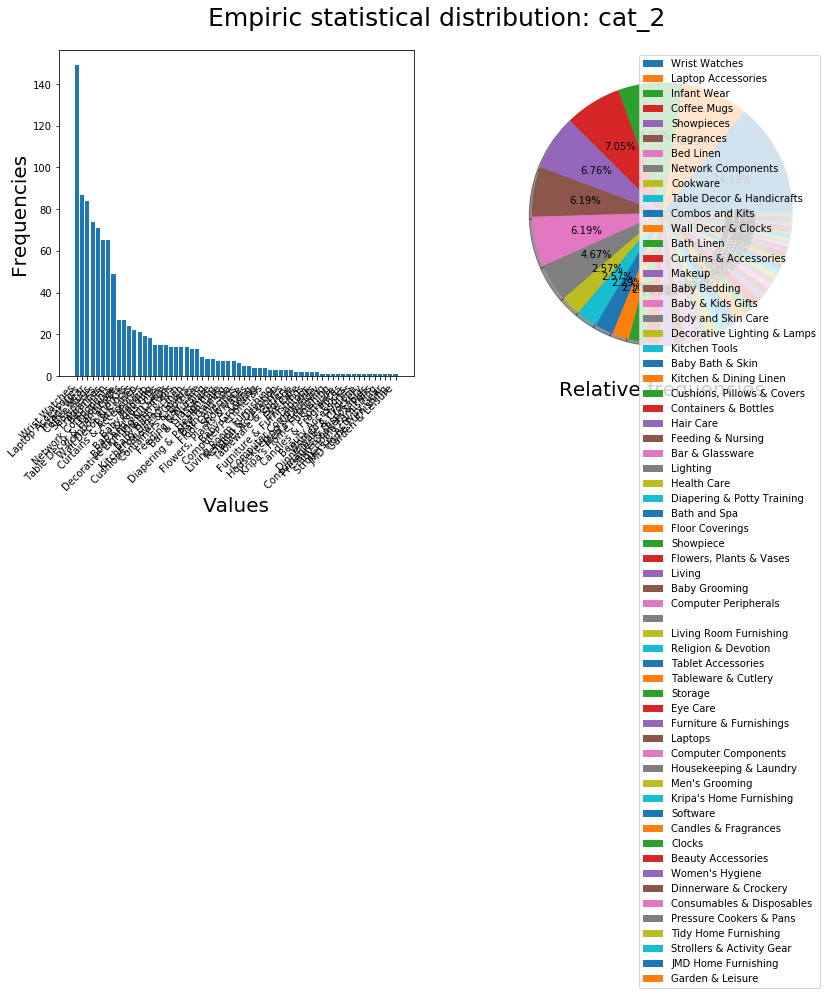

In [14]:
fig = functions_p6.categorical_distribution(data['cat_2'])

In [15]:
nb_cat3 = data['cat_3'].nunique()
print('There are {} categories at 3rd level.'.format(nb_cat3))

There are 144 categories at 3rd level.


# Extraction des données depuis l'API Amazon

[Documentation](https://docs.aws.amazon.com/fr_fr/AWSECommerceService/latest/DG/ItemSearch.html)

Contraintes : 1'000 lignes sur un unique type d'articles, peu présent dans l'échantillon actuel

SearchIndex ou BrowseNode avec catégories : [catégories](https://docs.aws.amazon.com/en_pv/AWSECommerceService/latest/DG/LocaleUS.html)

## API Amazon

[Getting Started with Product Advertising API](https://docs.aws.amazon.com/fr_fr/AWSECommerceService/latest/GSG/GettingStarted.html)

Becoming an Associate

Becoming a Product Advertising API Developer



[A simple Python wrapper for the Amazon.com Product Advertising API](https://github.com/yoavaviram/python-amazon-simple-product-api)

## Flickr API
https://www.flickr.com/services/apps/create


In [16]:
import config.flickr_config as config

FLICKR_KEY = config.FLICKR_KEY
FLICKR_SECRET = config.FLICKR_SECRET

In [17]:
import flickrapi

# Setup for the flickr API
flickr = flickrapi.FlickrAPI(FLICKR_KEY, FLICKR_SECRET, format='parsed-json')

# Query for 10 images of 'watches'
res = flickr.photos.search(text='watches', per_page=10, sort='relevance')

# Extract the photos' records from the response to query
photos = res['photos']['photo']

In [18]:
from IPython.core.display import HTML

# Create the photos' URL from the record 
def flickr_url(photo, size=''):
    url = 'http://farm{farm}.staticflickr.com/{server}/{id}_{secret}{size}.jpg'
    if size:
        size = '_' + size
    return url.format(size=size, **photo)

# Create the html code for displaying the images
tags = ['<img src="{}" width="150" style="display:inline"/>'
       .format(flickr_url(photo)) for photo in photos]

# Display the images
HTML(''.join(tags))

In [19]:
import multiprocessing
from functools import partial
import urllib.request

# Download the photo in the specified directory
def fetch_photo(dir_name, photo):
    urllib.request.urlretrieve(flickr_url(photo), os.path.join(dir_name, photo['id'] + '.jpg'))

# Download a specified number of images from Flickr API
def fetch_image_set(query, dir_name=None, count=250, sort='relevance'):
    photos = flickr.photos.search(text='"{}"'.format(query),
                              per_page=count,
                              sort=sort)['photos']['photo']
    dir_name = dir_name or query
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)
    
    # Download each photo
    for photo in photos:
        fetch_photo(dir_name, photo)

# Analyse du jeu de données

## Prétraitement

### Textes : descriptions des produits

#### Nettoyage : stop-words, ponctuation

In [20]:
data['description'].loc[0]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

#### Encodage : bag-of-words et TFIDF

In [21]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

vectorizer = TfidfVectorizer(
    strip_accents='unicode',
    lowercase=True,
    stop_words='english',
    analyzer='word',
    max_df=0.8,
    min_df=2,
    ngram_range=(1, 1),
)

In [22]:
corpus = data['description']
X = vectorizer.fit_transform(corpus)

X.shape

(1050, 2442)

In [23]:
len(list(vectorizer.vocabulary_))

2442

In [24]:
len(vectorizer.stop_words_)

3400

In [25]:
X_dense = X.todense()

### Images : photos des produits

#### Redimensionnement, conversion & blanc, contraste…

In [26]:
from PIL import Image
import os

image_name = data['image'].loc[1]
dir_name = 'data/Images'
img_path = os.path.join(dir_name, image_name)
jpgfile = Image.open(img_path)

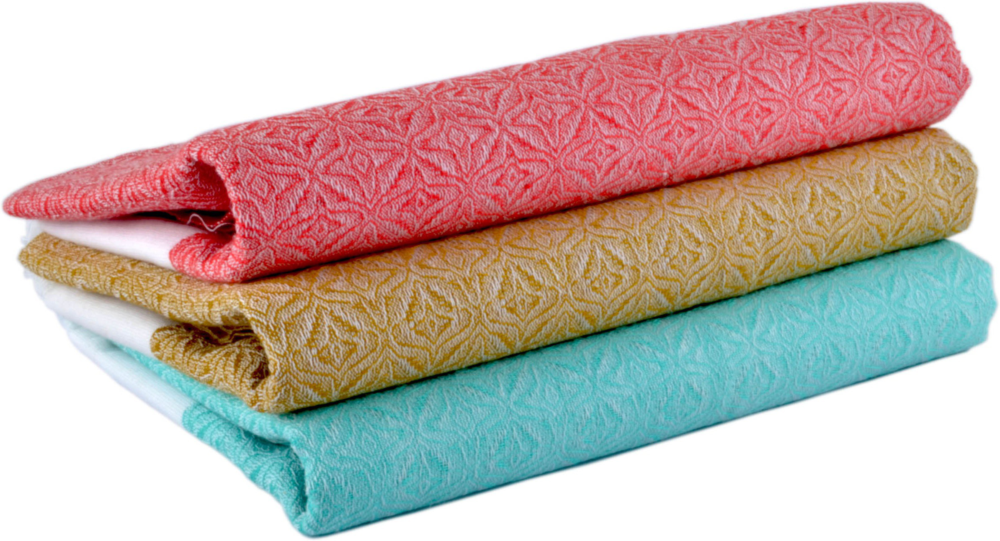

In [27]:
display(jpgfile)

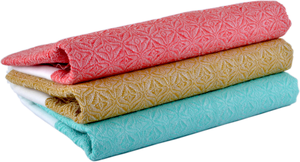

In [28]:
import PIL
from PIL import Image

basewidth = 300
wpercent = (basewidth / float(jpgfile.size[0]))
hsize = int((float(jpgfile.size[1]) * float(wpercent)))
jpgfile = jpgfile.resize((basewidth, hsize), PIL.Image.ANTIALIAS)
display(jpgfile)

dir_name = 'data/preprocessed_images'
file_path = os.path.join(dir_name, image_name)
jpgfile.save(file_path)

#### Détections de features : algorithme de type SIFT / ORB / SURF

##### Extraction des features et descripteurs

In [29]:
import cv2 # opencv library for computer vision
orb = cv2.ORB_create()

def get_descriptors(image_path):
    
    # load image and convert it to grayscale
    img_gray = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # plt.imshow(img_color, cmap='gray', vmin=0, vmax=255)

    # detect key points and descriptors
    keypoints, descriptors = orb.detectAndCompute(img_gray, None)

    # returns keypoints and descriptors
    return keypoints, descriptors

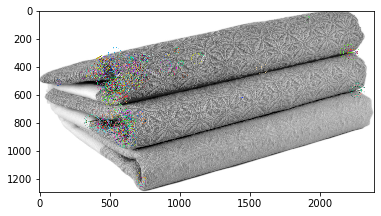

In [31]:
# get descriptors of the image
img_keypoints, img_descriptors = get_descriptors(img_path)

# get the image in gray
img_gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

# melt the image with keypoints
img_kp = cv2.drawKeypoints(
    image=img_gray,
    keypoints=img_keypoints,
    outImage=None,
    flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# show the grey image with keypoints
plt.imshow(img_kp)

#### "Bags of visual words" (BOVW)

In [34]:
print("We get, for each image, {} keypoints and descriptors of {} dimensions."
      .format(img_descriptors.shape[0], img_descriptors.shape[1]))

We get, for each image, 500 keypoints and descriptors of 32 dimensions.


##### Aggrégation des features

In [35]:
from PIL import Image
import os
import cv2 # opencv library for computer vision

# initializations
orb = cv2.ORB_create()
dir_name = 'data/Images'
data.loc[:,'descriptors'] = pd.Series(index=data.index)
data['descriptors'] = data['descriptors'].astype(object)

# computing descriptors for each image of product
for index, row in data.iterrows():
    
    # get url of the product's image
    img_name = row['image']
    
    # create the path to the image file
    img_path = os.path.join(dir_name, img_name)
    
    # get the keypoints and descriptors of image
    img_keypoints, img_descriptors = get_descriptors(img_path)
    
    # add descriptors into a new column of the dataframe
    data.at[index, 'descriptors'] = img_descriptors

In [61]:
data.loc[343]
img_name = '9743e6d1c9f3180483825fe4d2e97836.jpg'
img_path = os.path.join(dir_name, img_name)

# load image and convert it to grayscale
img_gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
plt.imshow(img_gray, cmap='gray', vmin=0, vmax=255)

KeyError: 343

In [58]:
# Removing a problematic picture (n°343, '9743e6d1c9f3180483825fe4d2e97836.jpg')
# Should try by applying a contrast rescaling
mask = (data['descriptors'].notnull())
data = data[mask]

In [60]:
# agregation of the descriptors of ALL images
for index, row in data.iterrows():
    if 'descriptors' not in globals():
        # creation of the agregation object for descriptors
        descriptors = row['descriptors']
    else:
        # concatenation of the descriptors
        descriptors = np.concatenate((descriptors, row['descriptors']), axis=0) 

print(descriptors.shape)

(1342134, 32)


##### Segmentation des features

In [62]:
# %%flake8  # checking PEP8 compliance

import random
from random import randrange

# Set random integer (seed)
seed = random.randrange(1000)

# Initialize the seed of pseudo-random generator
random.seed(seed)
print("Seed value: ", seed)

Seed value:  429


In [63]:
from sklearn.cluster import MiniBatchKMeans

# set the size of the vocabulary of visual words
vocabulary_size = 1000

# instanciate a clustering model
kmeans = MiniBatchKMeans(
    n_clusters=vocabulary_size,
    random_state=seed,
    init_size=3000,
)

# apply the clustering model
kmeans.fit(descriptors)

MiniBatchKMeans(batch_size=100, compute_labels=True, init='k-means++',
                init_size=3000, max_iter=100, max_no_improvement=10,
                n_clusters=1000, n_init=3, random_state=429,
                reassignment_ratio=0.01, tol=0.0, verbose=0)

##### Histogrammes des "bags-of-visual-words"

In [64]:
# Function to convert list of values to a value:frequency dict
def list_to_dict(my_list):
    dictionnary = {}
    for item in my_list:
        if item not in dictionnary.keys():
            dictionnary[item] = 1
        else:
            dictionnary[item] += 1
    return dictionnary

In [66]:
# initialization
data.loc[:,'visual_words'] = pd.Series(index=data.index)
data['visual_words'] = data['visual_words'].astype(object)

# for each image, convert descriptors into a list of visual words
for index, row in data.iterrows():
    visual_words_predict = list(kmeans.predict(data.loc[index, 'descriptors']))
    data.at[index, 'visual_words'] = visual_words_predict

In [67]:
# %%flake8  # checking PEP8 compliance

def frequency_encoding(dataframe, feature, prefix):

    # ------------------------------------------------
    # Function to convert list of values to a value:frequency dict
    def list_to_dict(my_list):
        dictionnary = {}
        for item in my_list:
            if item not in dictionnary.keys():
                dictionnary[item] = 1
            else:
                dictionnary[item] += 1
        return dictionnary
    
    # ------------------------------------------------
    # Function to FrequencyVectorize a dictionnary
    def frequency_encoding_from_dict(dictionnary):
        frequencies = pd.Series()
        total_frequency = sum(dictionnary.values())

        for key, value in dictionnary.items():
            frequencies[prefix + str(key)] = value / total_frequency

        return frequencies

    # ------------------------------------------------
    # Convert lists to dictionnary
    dataframe[feature] = dataframe[feature].apply(list_to_dict)

    # Proceed to the frequency encoding
    frequency_df = dataframe[feature]\
        .apply(frequency_encoding_from_dict).fillna(0)

    # Return the frequency_encoding pd.DataFrame
    return frequency_df

In [68]:
# frequency encoding of bags-of-visual-words
# get the DataFrame with frequency encoded data
frequency_df = frequency_encoding(data, 'visual_words', 'vw_')

# add the columns to the data_customers table
data = pd.concat(
    [data, frequency_df],
    sort=False,
    axis=1
)

In [69]:
data.head(2)

,uniq_id,product_name,product_category_tree,image,description,cat_1,cat_2,cat_3,descriptors,visual_words,vw_255,vw_967,vw_64,vw_734,vw_391,vw_741,vw_244,vw_384,vw_810,vw_80,vw_266,vw_521,vw_992,vw_159,vw_894,vw_699,vw_408,vw_831,vw_718,vw_597,vw_181,vw_5,vw_706,vw_760,vw_948,vw_663,vw_501,vw_742,vw_627,vw_6,vw_70,vw_833,vw_248,vw_82,vw_202,vw_996,vw_557,vw_165,vw_587,vw_210,vw_45,vw_94,vw_42,vw_647,vw_427,vw_7,vw_535,vw_383,vw_406,vw_711,vw_112,vw_447,vw_228,vw_213,vw_545,vw_626,vw_121,vw_566,vw_430,vw_39,vw_989,vw_582,vw_702,vw_395,vw_326,vw_271,vw_485,vw_276,vw_329,vw_236,vw_688,vw_514,vw_287,vw_921,vw_222,vw_675,vw_111,vw_319,vw_32,vw_895,vw_935,vw_678,vw_495,vw_259,vw_565,vw_416,vw_573,vw_270,vw_342,vw_947,vw_966,vw_195,vw_570,vw_303,vw_750,vw_644,vw_415,vw_33,vw_227,vw_35,vw_620,vw_887,vw_388,vw_603,vw_132,vw_885,vw_637,vw_613,vw_196,vw_687,vw_30,vw_122,vw_527,vw_924,vw_781,vw_753,vw_174,vw_730,vw_604,vw_474,vw_403,vw_766,vw_13,vw_480,vw_801,vw_899,vw_114,vw_471,vw_120,vw_920,vw_617,vw_868,vw_404,vw_362,vw_556,vw_717,vw_268,vw_562,vw_51,vw_832,vw_20,vw_645,vw_829,vw_752,vw_321,vw_897,vw_426,vw_961,vw_909,vw_569,vw_676,vw_985,vw_396,vw_469,vw_851,vw_919,vw_546,vw_281,vw_968,vw_229,vw_848,vw_88,vw_667,vw_131,vw_639,vw_744,vw_183,vw_940,vw_147,vw_600,vw_870,vw_446,vw_942,vw_96,vw_981,vw_21,vw_66,vw_25,vw_629,vw_53,vw_488,vw_375,vw_124,vw_824,vw_884,vw_158,vw_470,vw_277,vw_618,vw_977,vw_335,vw_694,vw_180,vw_207,vw_756,vw_890,vw_27,vw_783,vw_357,vw_108,vw_265,vw_138,vw_791,vw_841,vw_250,vw_161,vw_794,vw_863,vw_937,vw_599,vw_185,vw_939,vw_817,vw_429,vw_943,vw_712,vw_879,vw_52,vw_498,vw_999,vw_337,vw_10,vw_641,vw_333,vw_67,vw_544,vw_914,vw_855,vw_73,vw_215,vw_28,vw_417,vw_3,vw_234,vw_798,vw_681,vw_191,vw_296,vw_373,vw_68,vw_579,vw_782,vw_153,vw_813,vw_74,vw_789,vw_526,vw_623,vw_812,vw_368,vw_487,vw_48,vw_595,vw_164,vw_755,vw_583,vw_55,vw_749,vw_242,vw_235,vw_374,vw_972,vw_918,vw_775,vw_15,vw_803,vw_489,vw_435,vw_591,vw_72,vw_733,vw_327,vw_729,vw_666,vw_135,vw_352,vw_649,vw_62,vw_807,vw_293,vw_878,vw_531,vw_548,vw_965,vw_238,vw_503,vw_299,vw_640,vw_353,vw_685,vw_359,vw_154,vw_606,vw_468,vw_508,vw_785,vw_400,vw_575,vw_761,vw_432,vw_984,vw_71,vw_845,vw_866,vw_57,vw_500,vw_816,vw_286,vw_156,vw_472,vw_589,vw_445,vw_808,vw_631,vw_371,vw_177,vw_37,vw_607,vw_840,vw_223,vw_450,vw_652,vw_127,vw_316,vw_923,vw_776,vw_857,vw_246,vw_392,vw_830,vw_516,vw_208,vw_382,vw_424,vw_40,vw_292,vw_534,vw_552,vw_149,vw_993,vw_929,vw_697,vw_69,vw_661,vw_237,vw_184,vw_662,vw_672,vw_769,vw_355,vw_422,vw_36,vw_61,vw_267,vw_274,vw_991,vw_409,vw_633,vw_90,vw_311,vw_590,vw_393,vw_574,vw_915,vw_693,vw_385,vw_58,vw_852,vw_577,vw_297,vw_434,vw_911,vw_538,vw_596,vw_245,vw_399,vw_954,vw_148,vw_946,vw_117,vw_670,vw_263,vw_11,vw_927,vw_612,vw_630,vw_804,vw_128,vw_764,vw_251,vw_486,vw_762,vw_549,vw_134,vw_16,vw_38,vw_226,vw_969,vw_826,vw_695,vw_888,vw_413,vw_864,vw_496,vw_170,vw_176,vw_765,vw_758,vw_146,vw_910,vw_306,vw_971,vw_686,vw_726,vw_846,vw_49,vw_492,vw_882,vw_289,vw_913,vw_483,vw_517,vw_743,vw_707,vw_216,vw_257,vw_874,vw_698,vw_275,vw_774,vw_872,vw_519,vw_389,vw_89,vw_745,vw_300,vw_221,vw_731,vw_680,vw_818,vw_696,vw_881,vw_479,vw_317,vw_394,vw_951,vw_820,vw_356,vw_129,vw_551,vw_444,vw_364,vw_926,vw_994,vw_737,vw_173,vw_31,vw_465,vw_4,vw_858,vw_350,vw_792,vw_905,vw_18,vw_438,vw_60,vw_440,vw_889,vw_838,vw_518,vw_309,vw_56,vw_110,vw_233,vw_325,vw_463,vw_412,vw_708,vw_433,vw_513,vw_974,vw_334,vw_949,vw_624,vw_987,vw_771,vw_936,vw_809,vw_505,vw_50,...,vw_873,vw_318,vw_611,vw_457,vw_302,vw_656,vw_856,vw_152,vw_155,vw_614,vw_312,vw_541,vw_369,vw_862,vw_144,vw_456,vw_178,vw_358,vw_256,vw_75,vw_493,vw_199,vw_572,vw_709,vw_87,vw_239,vw_903,vw_437,vw_842,vw_175,vw_258,vw_328,vw_692,vw_360,vw_705,vw_211,vw_461,vw_141,vw_462,vw_825,vw_748,vw_455,vw_523,vw_93,vw_347,vw_381,vw_659,vw_137,vw_933,vw_655,vw_109,vw_376,vw_529,vw_140,vw_345,vw_294,vw_59,vw_405,vw_901,vw_814,vw_9,vw_209,vw_736,vw_679,vw_780,vw_113,vw_916,vw_247,vw_986,vw_962,vw_291,vw_522,vw_119,vw_150,vw_261,vw_72

#### Détections de features : algorithme de type CNN Transfer Learning
* "convolutionnal base" of VGG16 architecture (2014) ou autre modèle "état de l'art"
* 
Quel format pour les images en entrée ?

In [70]:
from keras.applications import VGG16

conv_base = VGG16(weights='imagenet',
                 include_top=False,
                 input_shape=(150,150,3))

conv_base.summary()

Using TensorFlow backend.








_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 150, 150, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
____

##### Extraction des features sans augmentation des données

Found 2055 images belonging to 3 classes.
(20, 150, 150, 3)


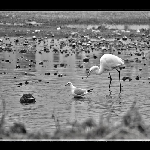

(20, 150, 150, 3)


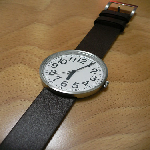

(20, 150, 150, 3)


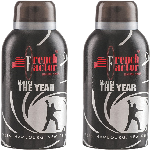

In [71]:
import os
import numpy as np
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing import image

dir_name = 'data'

# instanciation of the generator of batchs
datagen = ImageDataGenerator(rescale=1./255)
batch_size = 20

def extract_features(directory, sample_count):
    features = np.zeros(shape=(sample_count, 4, 4, 512))
    labels = np.zeros(shape=(sample_count))
    generator = datagen.flow_from_directory(
        directory,
        target_size=(150, 150),
        batch_size=batch_size,
        class_mode=None, # 'categorical'. None : no labels
    )
    i = 0
    for inputs_batch in generator:
        print(inputs_batch.shape)
        display(image.array_to_img(inputs_batch[0]))
        features_batch = conv_base.predict(inputs_batch)
        
        try:
            features[i * batch_size : (i + 1) * batch_size] = features_batch
        # if number of images is not a multiple of batch_size
        except ValueError:
            break
            
        # labels[i * batch_size : (i + 1) * batch_size] = labels_batch
        i += 1
        
        # break after every image has been seen once
        if i * batch_size >= sample_count:
            break
            
    return features # , labels

features = extract_features(dir_name, 50)

##### Applatissement des features

In [72]:
features.shape

(50, 4, 4, 512)

In [73]:
features = np.reshape(features, (features.shape[0], 4 * 4 * 512))

features.shape[1]

8192

## Réduction de dimensions

In [77]:
data.head(1)

,uniq_id,product_name,product_category_tree,image,description,cat_1,cat_2,cat_3,descriptors,visual_words,vw_255,vw_967,vw_64,vw_734,vw_391,vw_741,vw_244,vw_384,vw_810,vw_80,vw_266,vw_521,vw_992,vw_159,vw_894,vw_699,vw_408,vw_831,vw_718,vw_597,vw_181,vw_5,vw_706,vw_760,vw_948,vw_663,vw_501,vw_742,vw_627,vw_6,vw_70,vw_833,vw_248,vw_82,vw_202,vw_996,vw_557,vw_165,vw_587,vw_210,vw_45,vw_94,vw_42,vw_647,vw_427,vw_7,vw_535,vw_383,vw_406,vw_711,vw_112,vw_447,vw_228,vw_213,vw_545,vw_626,vw_121,vw_566,vw_430,vw_39,vw_989,vw_582,vw_702,vw_395,vw_326,vw_271,vw_485,vw_276,vw_329,vw_236,vw_688,vw_514,vw_287,vw_921,vw_222,vw_675,vw_111,vw_319,vw_32,vw_895,vw_935,vw_678,vw_495,vw_259,vw_565,vw_416,vw_573,vw_270,vw_342,vw_947,vw_966,vw_195,vw_570,vw_303,vw_750,vw_644,vw_415,vw_33,vw_227,vw_35,vw_620,vw_887,vw_388,vw_603,vw_132,vw_885,vw_637,vw_613,vw_196,vw_687,vw_30,vw_122,vw_527,vw_924,vw_781,vw_753,vw_174,vw_730,vw_604,vw_474,vw_403,vw_766,vw_13,vw_480,vw_801,vw_899,vw_114,vw_471,vw_120,vw_920,vw_617,vw_868,vw_404,vw_362,vw_556,vw_717,vw_268,vw_562,vw_51,vw_832,vw_20,vw_645,vw_829,vw_752,vw_321,vw_897,vw_426,vw_961,vw_909,vw_569,vw_676,vw_985,vw_396,vw_469,vw_851,vw_919,vw_546,vw_281,vw_968,vw_229,vw_848,vw_88,vw_667,vw_131,vw_639,vw_744,vw_183,vw_940,vw_147,vw_600,vw_870,vw_446,vw_942,vw_96,vw_981,vw_21,vw_66,vw_25,vw_629,vw_53,vw_488,vw_375,vw_124,vw_824,vw_884,vw_158,vw_470,vw_277,vw_618,vw_977,vw_335,vw_694,vw_180,vw_207,vw_756,vw_890,vw_27,vw_783,vw_357,vw_108,vw_265,vw_138,vw_791,vw_841,vw_250,vw_161,vw_794,vw_863,vw_937,vw_599,vw_185,vw_939,vw_817,vw_429,vw_943,vw_712,vw_879,vw_52,vw_498,vw_999,vw_337,vw_10,vw_641,vw_333,vw_67,vw_544,vw_914,vw_855,vw_73,vw_215,vw_28,vw_417,vw_3,vw_234,vw_798,vw_681,vw_191,vw_296,vw_373,vw_68,vw_579,vw_782,vw_153,vw_813,vw_74,vw_789,vw_526,vw_623,vw_812,vw_368,vw_487,vw_48,vw_595,vw_164,vw_755,vw_583,vw_55,vw_749,vw_242,vw_235,vw_374,vw_972,vw_918,vw_775,vw_15,vw_803,vw_489,vw_435,vw_591,vw_72,vw_733,vw_327,vw_729,vw_666,vw_135,vw_352,vw_649,vw_62,vw_807,vw_293,vw_878,vw_531,vw_548,vw_965,vw_238,vw_503,vw_299,vw_640,vw_353,vw_685,vw_359,vw_154,vw_606,vw_468,vw_508,vw_785,vw_400,vw_575,vw_761,vw_432,vw_984,vw_71,vw_845,vw_866,vw_57,vw_500,vw_816,vw_286,vw_156,vw_472,vw_589,vw_445,vw_808,vw_631,vw_371,vw_177,vw_37,vw_607,vw_840,vw_223,vw_450,vw_652,vw_127,vw_316,vw_923,vw_776,vw_857,vw_246,vw_392,vw_830,vw_516,vw_208,vw_382,vw_424,vw_40,vw_292,vw_534,vw_552,vw_149,vw_993,vw_929,vw_697,vw_69,vw_661,vw_237,vw_184,vw_662,vw_672,vw_769,vw_355,vw_422,vw_36,vw_61,vw_267,vw_274,vw_991,vw_409,vw_633,vw_90,vw_311,vw_590,vw_393,vw_574,vw_915,vw_693,vw_385,vw_58,vw_852,vw_577,vw_297,vw_434,vw_911,vw_538,vw_596,vw_245,vw_399,vw_954,vw_148,vw_946,vw_117,vw_670,vw_263,vw_11,vw_927,vw_612,vw_630,vw_804,vw_128,vw_764,vw_251,vw_486,vw_762,vw_549,vw_134,vw_16,vw_38,vw_226,vw_969,vw_826,vw_695,vw_888,vw_413,vw_864,vw_496,vw_170,vw_176,vw_765,vw_758,vw_146,vw_910,vw_306,vw_971,vw_686,vw_726,vw_846,vw_49,vw_492,vw_882,vw_289,vw_913,vw_483,vw_517,vw_743,vw_707,vw_216,vw_257,vw_874,vw_698,vw_275,vw_774,vw_872,vw_519,vw_389,vw_89,vw_745,vw_300,vw_221,vw_731,vw_680,vw_818,vw_696,vw_881,vw_479,vw_317,vw_394,vw_951,vw_820,vw_356,vw_129,vw_551,vw_444,vw_364,vw_926,vw_994,vw_737,vw_173,vw_31,vw_465,vw_4,vw_858,vw_350,vw_792,vw_905,vw_18,vw_438,vw_60,vw_440,vw_889,vw_838,vw_518,vw_309,vw_56,vw_110,vw_233,vw_325,vw_463,vw_412,vw_708,vw_433,vw_513,vw_974,vw_334,vw_949,vw_624,vw_987,vw_771,vw_936,vw_809,vw_505,vw_50,...,vw_873,vw_318,vw_611,vw_457,vw_302,vw_656,vw_856,vw_152,vw_155,vw_614,vw_312,vw_541,vw_369,vw_862,vw_144,vw_456,vw_178,vw_358,vw_256,vw_75,vw_493,vw_199,vw_572,vw_709,vw_87,vw_239,vw_903,vw_437,vw_842,vw_175,vw_258,vw_328,vw_692,vw_360,vw_705,vw_211,vw_461,vw_141,vw_462,vw_825,vw_748,vw_455,vw_523,vw_93,vw_347,vw_381,vw_659,vw_137,vw_933,vw_655,vw_109,vw_376,vw_529,vw_140,vw_345,vw_294,vw_59,vw_405,vw_901,vw_814,vw_9,vw_209,vw_736,vw_679,vw_780,vw_113,vw_916,vw_247,vw_986,vw_962,vw_291,vw_522,vw_119,vw_150,vw_261,vw_72

In [74]:
y = data['cat_1']

In [79]:
X = data.iloc[:,10:]
X.head()

,vw_255,vw_967,vw_64,vw_734,vw_391,vw_741,vw_244,vw_384,vw_810,vw_80,vw_266,vw_521,vw_992,vw_159,vw_894,vw_699,vw_408,vw_831,vw_718,vw_597,vw_181,vw_5,vw_706,vw_760,vw_948,vw_663,vw_501,vw_742,vw_627,vw_6,vw_70,vw_833,vw_248,vw_82,vw_202,vw_996,vw_557,vw_165,vw_587,vw_210,vw_45,vw_94,vw_42,vw_647,vw_427,vw_7,vw_535,vw_383,vw_406,vw_711,vw_112,vw_447,vw_228,vw_213,vw_545,vw_626,vw_121,vw_566,vw_430,vw_39,vw_989,vw_582,vw_702,vw_395,vw_326,vw_271,vw_485,vw_276,vw_329,vw_236,vw_688,vw_514,vw_287,vw_921,vw_222,vw_675,vw_111,vw_319,vw_32,vw_895,vw_935,vw_678,vw_495,vw_259,vw_565,vw_416,vw_573,vw_270,vw_342,vw_947,vw_966,vw_195,vw_570,vw_303,vw_750,vw_644,vw_415,vw_33,vw_227,vw_35,vw_620,vw_887,vw_388,vw_603,vw_132,vw_885,vw_637,vw_613,vw_196,vw_687,vw_30,vw_122,vw_527,vw_924,vw_781,vw_753,vw_174,vw_730,vw_604,vw_474,vw_403,vw_766,vw_13,vw_480,vw_801,vw_899,vw_114,vw_471,vw_120,vw_920,vw_617,vw_868,vw_404,vw_362,vw_556,vw_717,vw_268,vw_562,vw_51,vw_832,vw_20,vw_645,vw_829,vw_752,vw_321,vw_897,vw_426,vw_961,vw_909,vw_569,vw_676,vw_985,vw_396,vw_469,vw_851,vw_919,vw_546,vw_281,vw_968,vw_229,vw_848,vw_88,vw_667,vw_131,vw_639,vw_744,vw_183,vw_940,vw_147,vw_600,vw_870,vw_446,vw_942,vw_96,vw_981,vw_21,vw_66,vw_25,vw_629,vw_53,vw_488,vw_375,vw_124,vw_824,vw_884,vw_158,vw_470,vw_277,vw_618,vw_977,vw_335,vw_694,vw_180,vw_207,vw_756,vw_890,vw_27,vw_783,vw_357,vw_108,vw_265,vw_138,vw_791,vw_841,vw_250,vw_161,vw_794,vw_863,vw_937,vw_599,vw_185,vw_939,vw_817,vw_429,vw_943,vw_712,vw_879,vw_52,vw_498,vw_999,vw_337,vw_10,vw_641,vw_333,vw_67,vw_544,vw_914,vw_855,vw_73,vw_215,vw_28,vw_417,vw_3,vw_234,vw_798,vw_681,vw_191,vw_296,vw_373,vw_68,vw_579,vw_782,vw_153,vw_813,vw_74,vw_789,vw_526,vw_623,vw_812,vw_368,vw_487,vw_48,vw_595,vw_164,vw_755,vw_583,vw_55,vw_749,vw_242,vw_235,vw_374,vw_972,vw_918,vw_775,vw_15,vw_803,vw_489,vw_435,vw_591,vw_72,vw_733,vw_327,vw_729,vw_666,vw_135,vw_352,vw_649,vw_62,vw_807,vw_293,vw_878,vw_531,vw_548,vw_965,vw_238,vw_503,vw_299,vw_640,vw_353,vw_685,vw_359,vw_154,vw_606,vw_468,vw_508,vw_785,vw_400,vw_575,vw_761,vw_432,vw_984,vw_71,vw_845,vw_866,vw_57,vw_500,vw_816,vw_286,vw_156,vw_472,vw_589,vw_445,vw_808,vw_631,vw_371,vw_177,vw_37,vw_607,vw_840,vw_223,vw_450,vw_652,vw_127,vw_316,vw_923,vw_776,vw_857,vw_246,vw_392,vw_830,vw_516,vw_208,vw_382,vw_424,vw_40,vw_292,vw_534,vw_552,vw_149,vw_993,vw_929,vw_697,vw_69,vw_661,vw_237,vw_184,vw_662,vw_672,vw_769,vw_355,vw_422,vw_36,vw_61,vw_267,vw_274,vw_991,vw_409,vw_633,vw_90,vw_311,vw_590,vw_393,vw_574,vw_915,vw_693,vw_385,vw_58,vw_852,vw_577,vw_297,vw_434,vw_911,vw_538,vw_596,vw_245,vw_399,vw_954,vw_148,vw_946,vw_117,vw_670,vw_263,vw_11,vw_927,vw_612,vw_630,vw_804,vw_128,vw_764,vw_251,vw_486,vw_762,vw_549,vw_134,vw_16,vw_38,vw_226,vw_969,vw_826,vw_695,vw_888,vw_413,vw_864,vw_496,vw_170,vw_176,vw_765,vw_758,vw_146,vw_910,vw_306,vw_971,vw_686,vw_726,vw_846,vw_49,vw_492,vw_882,vw_289,vw_913,vw_483,vw_517,vw_743,vw_707,vw_216,vw_257,vw_874,vw_698,vw_275,vw_774,vw_872,vw_519,vw_389,vw_89,vw_745,vw_300,vw_221,vw_731,vw_680,vw_818,vw_696,vw_881,vw_479,vw_317,vw_394,vw_951,vw_820,vw_356,vw_129,vw_551,vw_444,vw_364,vw_926,vw_994,vw_737,vw_173,vw_31,vw_465,vw_4,vw_858,vw_350,vw_792,vw_905,vw_18,vw_438,vw_60,vw_440,vw_889,vw_838,vw_518,vw_309,vw_56,vw_110,vw_233,vw_325,vw_463,vw_412,vw_708,vw_433,vw_513,vw_974,vw_334,vw_949,vw_624,vw_987,vw_771,vw_936,vw_809,vw_505,vw_50,vw_288,vw_102,vw_411,vw_420,vw_689,vw_727,vw_220,vw_507,vw_79,vw_650,vw_873,vw_318,vw_611,vw_457,vw_302,vw_656,vw_856,vw_152,vw_155,vw_614,vw_312,vw_541,vw_369,vw_862,vw_144,vw_456,vw_178,vw_358,vw_256,vw_75,vw_493,vw_199,vw_572,vw_709,vw_87,vw_239,vw_903,vw_437,vw_842,vw_175,vw_258,vw_328,vw_692,vw_360,vw_705,vw_211,vw_461,vw_141,vw_462,vw_825,vw_748,vw_455,vw_523,vw_93,vw_347,vw_381,vw_659,vw_137,vw_933,vw_655,vw_109,vw_376,vw_529,vw_140,vw_345,vw_294,vw_59,vw_405,vw_901,vw_814,vw_9,vw_209,vw_736,vw_679,vw_780,vw_113,vw_916,vw_247,vw_986,vw_962,vw_291,vw_522,vw_119,vw_150,vw_261,vw_721,vw_700,vw_608,vw_386,vw_983,vw_978,vw

In [80]:
# %%flake8  # checking PEP8 compliance

from sklearn.preprocessing import StandardScaler

# Apply the standard scaler to the features
X_std = StandardScaler().fit_transform(X)

In [81]:
#-----------------------------------------------------------------------
def PCA_features_reduction(X_std, var_threshold=0.9):
    """Return the principal components from PCA, until variance threshold."""

    from sklearn import decomposition
    
    # 
    print("Initial number of features:", X_std.shape[1])
    
    # Processing the PCA
    pca = decomposition.PCA()
    pca.fit(X_std)
    
    # Getting the explained variance ratio for each principal component
    scree = pca.explained_variance_ratio_

    # Getting the number of principal components to reach variance thresholds
    mask = scree.cumsum() > var_threshold
    nb_selected_features = len(scree[~mask]) + 1
    print("Number of selected features:", nb_selected_features)
    
    # Compute and displays the actual ratio of explained variance
    explained_variance_sum = scree.cumsum()[nb_selected_features-1]
    print("Cumulative explained variance:  {:.2f}%".format(explained_variance_sum*100))
    
    # Getting the projection of the data on the first components
    X_projected = pca.transform(X_std)[:,:nb_selected_features]
    
    return X_projected

In [82]:
# Proceed to features reduction, up to 90% of variance
X_pca = PCA_features_reduction(
    X_std,
    var_threshold=0.9
)

Initial number of features: 1000
Number of selected features: 456
Cumulative explained variance:  90.03%


## Clustering ?????

### Clustering ???

### Représentation en 2 dimensions
Avec coloration des points en fonction de la catégorie de produit et glyphe en fonction du cluster ?

ARI entre le clustering obtenu et la segmentation par catégorie ???

In [83]:
def tSNE_plot(features_std, target, random_state=None):
    """Compute the tSNE. Displays the embedding on 2 dimensions."""
    
    target_name = target.name
    y = target
    
    # Applying the t-SNE
    #-------------------
    # Import libraries
    from sklearn import manifold

    # Instanciation of t-SNE
    tsne = manifold.TSNE(n_components=2, # projection in a plane
                         perplexity=30,
                         n_iter=300,
                         init='pca', # initialisation by a PCA
                         random_state=random_state
                        )

    # Applying the t-SNE
    features_projected = tsne.fit_transform(features_std) # t-SNE do not have ".transform" method

    # Plotting the t-SNE embedding
    #-----------------------------
    plt.figure(figsize=(12,7))

    # Definitions of axis boundaries
    plt.xlim(features_projected[:,0].min()*1.1, features_projected[:,0].max()*1.1)
    plt.ylim(features_projected[:,1].min()*1.1, features_projected[:,1].max()*1.1)

    # Definition of axis'labels
    plt.title("t-SNE\n", fontsize=20)
    plt.xlabel("t-SNE feature 1")
    plt.ylabel("t-SNE feature 2")
    
    # For each category in the target
    for i, category in enumerate(y.unique()):
        mask = (y == category)
        features_subset = features_projected[mask]
        
        # Plotting the points of the category
        sc = plt.scatter(
            features_subset[:,0], # x-coordinate
            features_subset[:,1], # y-coordinate
            cmap=plt.cm.get_cmap('RdYlGn_r'), # colormap
            label=category
        )
    
    # Setting the legend   
    plt.legend()

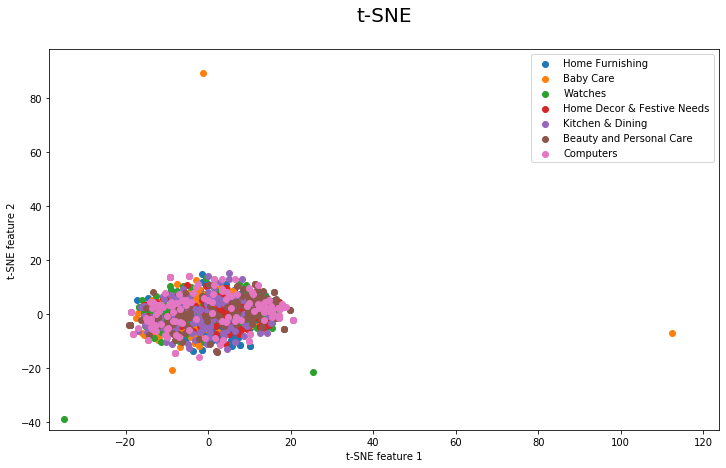

In [84]:
tSNE_plot(X_pca, y)

# Conception de l'API ???

# Conclusions

## Faisabilité

 * récupération des données d'entraînement avec une API
 * détection/extraction des features
 * structure par projection
 * SIFT et SURF : algorithmes brevetés, utilisation commerciale payante. Alternative : ORB

## Recommandations pour la création

Réseau neuronal avec apprentissage conjoint texte et image (Keras, API fonctionnelle)

Classification sur l'une des 7 classes principales. 

Image : CNN transfert learning

Texte : 1D-convolutionnal layer

# Autre

## Questions

* clustering ?? classification plutôt ?
* classification avec des tenseurs en entrée (pour les photos), ou avec SIFT ?
* conception de l'API ?? Celle d'Amazon, de Flickr ou une autre à créer ?
* classification uniquement sur la catégorie principale ?
* algorithmes SIFT / ORB / SURF : obsolètes ?
* API Amazon : ne peut pas être testée. API alternative (flickr API) ?
* taille du vocabulaire pour les visual words ? hyper-paramètre à ajuster ?


## TODO list

* Comprendre les algorithmes SURF et ORB
* Aggréger les features du text et celles de l'image
* Recalibrer le contraste et la luminosité des images
* Sauvegarde des données textes et visuelles encodées
* latex tf-idf
* 